# Predicción de Demanda Energética con Forecasting Recursivo Multi-Step

Este notebook implementa un método de forecasting recursivo multi-step para predecir la demanda energética del día siguiente utilizando la clase `ForecasterRecursive` de skforecast.

## Descripción del Método

**Forecasting multi-step recursivo**: Este método consiste en utilizar las propias predicciones del modelo como valores de entrada para predecir el siguiente valor. Por ejemplo, para predecir los 5 valores siguientes de una serie temporal, se entrena un modelo para predecir el siguiente valor (t+1), y se utiliza este valor para predecir el siguiente (t+2), y así sucesivamente. Todo este proceso se automatiza con la clase `ForecasterRecursive`.

## Estructura del Notebook

1. **Carga y procesamiento de datos**
2. **Análisis exploratorio**
3. **Partición de datos (train/validation/test)**
4. **Implementación del modelo recursivo**
5. **Evaluación y visualización**
6. **Predicción del día siguiente**


In [1]:
# ==============================================================================
# IMPORTACIÓN DE LIBRERÍAS
# ==============================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

# Forecasting y machine learning
from skforecast.recursive import ForecasterRecursive
from skforecast.model_selection import TimeSeriesFold, backtesting_forecaster
from skforecast.preprocessing import RollingFeatures
from skforecast.plot import plot_residuals
from lightgbm import LGBMRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Configuración de visualización
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams.update({'font.size': 10})
sns.set_palette("husl")

print("✅ Librerías importadas correctamente")
print(f"📊 Pandas version: {pd.__version__}")
print(f"🔮 Skforecast disponible")
print(f"🌳 LightGBM disponible")


✅ Librerías importadas correctamente
📊 Pandas version: 2.3.2
🔮 Skforecast disponible
🌳 LightGBM disponible


## 1. Carga y Procesamiento de Datos

Cargamos los datos de demanda energética desde los archivos Excel y los procesamos para crear una serie temporal completa.


In [ ]:
def load_energy_data():
    """
    Carga y procesa los datos de demanda energética y demanda no atendida desde múltiples archivos Excel
    """
    import os
    import glob
    
    print("🔄 Cargando datos de demanda energética y demanda no atendida...")
    print("=" * 60)
    
    # Buscar archivos Excel en la carpeta demanda-energia-sin/
    data_folder = 'demanda-energia-sin'
    if not os.path.exists(data_folder):
        raise FileNotFoundError(f"No se encontró la carpeta '{data_folder}'")
    
    excel_files = glob.glob(os.path.join(data_folder, '*.xlsx'))
    excel_files.sort()
    
    if not excel_files:
        raise FileNotFoundError(f"No se encontraron archivos Excel en la carpeta '{data_folder}'")
    
    print(f"📁 Encontrados {len(excel_files)} archivos Excel")
    print(f"📂 Carpeta de datos: {os.path.abspath(data_folder)}")
    print(f"💾 Tamaño total de archivos: {sum(os.path.getsize(f) for f in excel_files) / (1024*1024):.2f} MB")
    
    # Cargar y combinar todos los archivos
    all_data = []
    total_records = 0
    successful_files = 0
    failed_files = 0
    
    print(f"\n📊 PROCESANDO ARCHIVOS:")
    print("-" * 40)
    
    for i, file_path in enumerate(excel_files, 1):
        try:
            # Leer archivo Excel con header en la fila 3
            df = pd.read_excel(file_path, header=3)
            
            # Extraer año del nombre del archivo
            year = os.path.basename(file_path).split('_')[-1].replace('.xlsx', '')
            df['year'] = int(year)
            
            all_data.append(df)
            total_records += df.shape[0]
            successful_files += 1
            
            print(f"  [{i:2d}/{len(excel_files)}] ✅ {os.path.basename(file_path):30s} | {df.shape[0]:6,} registros | {df.shape[1]:2d} columnas")
            
        except Exception as e:
            failed_files += 1
            print(f"  [{i:2d}/{len(excel_files)}] ❌ {os.path.basename(file_path):30s} | ERROR: {e}")
            continue
    
    if not all_data:
        raise ValueError("No se pudieron cargar archivos Excel válidos")
    
    # Combinar todos los datos
    print(f"\n🔄 COMBINANDO DATOS:")
    print("-" * 40)
    datos = pd.concat(all_data, ignore_index=True)
    
    print(f"📊 RESUMEN DE CARGA DE DATOS:")
    print("=" * 60)
    print(f"✅ Archivos procesados exitosamente: {successful_files}/{len(excel_files)}")
    print(f"❌ Archivos con errores: {failed_files}")
    print(f"📈 Total de registros cargados: {total_records:,}")
    print(f"📊 Dimensiones del dataset: {datos.shape[0]:,} filas × {datos.shape[1]} columnas")
    print(f"💾 Memoria utilizada: {datos.memory_usage(deep=True).sum() / (1024*1024):.2f} MB")
    print(f"📅 Rango de años: {datos['year'].min()} - {datos['year'].max()}")
    print(f"🗓️  Años únicos: {sorted(datos['year'].unique())}")
    
    # Mostrar información sobre las columnas disponibles
    print(f"\n📋 COLUMNAS DISPONIBLES:")
    print("-" * 40)
    for i, col in enumerate(datos.columns, 1):
        print(f"  {i:2d}. {col}")
    
    return datos

# Cargar los datos
datos_raw = load_energy_data()
print(f"\n📋 Columnas disponibles: {list(datos_raw.columns)}")
print(f"📅 Rango de años: {datos_raw['year'].min()} - {datos_raw['year'].max()}")


🔄 Cargando datos de demanda energética...
📁 Encontrados 24 archivos Excel
📂 Carpeta de datos: /home/will/dev/src/idbetwill/forecasting/demanda-energia-sin
💾 Tamaño total de archivos: 0.86 MB

📊 PROCESANDO ARCHIVOS:
----------------------------------------
  [ 1/24] ✅ Demanda_Energia_SIN_2000.xlsx  |    366 registros |  7 columnas
  [ 2/24] ✅ Demanda_Energia_SIN_2001.xlsx  |    365 registros |  7 columnas
  [ 3/24] ✅ Demanda_Energia_SIN_2002.xlsx  |    365 registros |  7 columnas
  [ 4/24] ✅ Demanda_Energia_SIN_2003.xlsx  |    365 registros |  7 columnas
  [ 5/24] ✅ Demanda_Energia_SIN_2004.xlsx  |    366 registros |  7 columnas
  [ 6/24] ✅ Demanda_Energia_SIN_2005.xlsx  |    365 registros |  7 columnas
  [ 7/24] ✅ Demanda_Energia_SIN_2006.xlsx  |    365 registros |  7 columnas
  [ 8/24] ✅ Demanda_Energia_SIN_2007.xlsx  |    365 registros |  7 columnas
  [ 9/24] ✅ Demanda_Energia_SIN_2008.xlsx  |    366 registros |  7 columnas
  [10/24] ✅ Demanda_Energia_SIN_2009.xlsx  |    365 registro

In [ ]:
def preprocess_data(datos_raw):
    """
    Procesa los datos para crear series temporales de demanda energética y demanda no atendida
    """
    print("🔄 PROCESANDO DATOS MULTI-OBJETIVO")
    print("=" * 60)
    print(f"📊 Datos de entrada: {datos_raw.shape[0]:,} filas × {datos_raw.shape[1]} columnas")
    print(f"💾 Memoria inicial: {datos_raw.memory_usage(deep=True).sum() / (1024*1024):.2f} MB")
    
    # Detectar columnas de fecha, demanda y demanda no atendida automáticamente
    date_columns = []
    demand_columns = []
    unmet_demand_columns = []
    
    print(f"\n🔍 DETECTANDO COLUMNAS:")
    print("-" * 40)
    
    for col in datos_raw.columns:
        col_lower = col.lower()
        if any(keyword in col_lower for keyword in ['fecha', 'date', 'time', 'tiempo']):
            date_columns.append(col)
        if any(keyword in col_lower for keyword in ['demanda', 'demand', 'consumo', 'consumption', 'energia', 'energy']):
            if 'no atendida' in col_lower or 'unmet' in col_lower:
                unmet_demand_columns.append(col)
            else:
                demand_columns.append(col)
    
    print(f"📅 Columnas de fecha detectadas: {date_columns}")
    print(f"⚡ Columnas de demanda detectadas: {demand_columns}")
    print(f"❌ Columnas de demanda no atendida detectadas: {unmet_demand_columns}")
    
    if not date_columns or not demand_columns:
        raise ValueError("No se detectaron columnas de fecha o demanda")
    
    # Usar las primeras columnas encontradas
    date_col = date_columns[0]
    demand_col = demand_columns[0]
    unmet_demand_col = unmet_demand_columns[0] if unmet_demand_columns else None
    
    print(f"✅ Usando columna de fecha: '{date_col}'")
    print(f"✅ Usando columna de demanda: '{demand_col}'")
    if unmet_demand_col:
        print(f"✅ Usando columna de demanda no atendida: '{unmet_demand_col}'")
    else:
        print("⚠️  No se encontró columna de demanda no atendida")
    
    # Preparar datos
    print(f"\n🔄 PREPARANDO DATOS:")
    print("-" * 40)
    
    if unmet_demand_col:
        datos = datos_raw[[date_col, demand_col, unmet_demand_col]].copy()
        datos.columns = ['Time', 'Demand', 'Unmet_Demand']
        print(f"📊 Datos seleccionados (3 variables): {datos.shape[0]:,} filas × {datos.shape[1]} columnas")
    else:
        datos = datos_raw[[date_col, demand_col]].copy()
        datos.columns = ['Time', 'Demand']
        print(f"📊 Datos seleccionados (2 variables): {datos.shape[0]:,} filas × {datos.shape[1]} columnas")
    
    # Convertir fecha y limpiar datos
    print(f"🕐 Convirtiendo fechas...")
    datos['Time'] = pd.to_datetime(datos['Time'], errors='coerce')
    
    # Contar valores nulos antes de limpiar
    nulos_antes = datos.isnull().sum().sum()
    print(f"❌ Valores nulos encontrados: {nulos_antes:,}")
    
    datos = datos.dropna()
    datos = datos.set_index('Time')
    datos = datos.sort_index()
    
    nulos_despues = datos.isnull().sum().sum()
    registros_eliminados = nulos_antes - nulos_despues
    print(f"🧹 Registros eliminados por nulos: {registros_eliminados:,}")
    print(f"📊 Datos después de limpieza: {datos.shape[0]:,} filas")
    
    # Crear datos horarios si son diarios
    freq_detected = pd.infer_freq(datos.index)
    print(f"\n🕐 ANÁLISIS DE FRECUENCIA:")
    print("-" * 40)
    print(f"🕐 Frecuencia detectada: {freq_detected}")
    
    if freq_detected is None or freq_detected == 'D':
        print("📅 Datos diarios detectados. Creando datos horarios simulados...")
        print(f"🔄 Procesando {len(datos):,} días...")
        
        datos_horarios = []
        dias_procesados = 0
        
        for fecha, row in datos.iterrows():
            for hora in range(24):
                # Patrón diario típico de demanda eléctrica
                if 8 <= hora <= 10 or 18 <= hora <= 20:  # Picos
                    factor = 1.2 + 0.3 * np.sin(2 * np.pi * hora / 24)
                elif 22 <= hora or hora <= 6:  # Valle nocturno
                    factor = 0.6 + 0.2 * np.sin(2 * np.pi * hora / 24)
                else:  # Base
                    factor = 0.8 + 0.2 * np.sin(2 * np.pi * hora / 24)
                
                # Agregar variabilidad aleatoria
                factor += np.random.normal(0, 0.1)
                factor = max(0.3, factor)
                
                demanda_horaria = row['Demand'] * factor / 24
                fecha_hora = pd.Timestamp(fecha.year, fecha.month, fecha.day, hora)
                
                registro_horario = {
                    'Time': fecha_hora,
                    'Demand': demanda_horaria
                }
                
                # Si hay demanda no atendida, simularla también
                if 'Unmet_Demand' in row:
                    # La demanda no atendida suele ser mayor en horas pico
                    if 8 <= hora <= 10 or 18 <= hora <= 20:  # Picos
                        unmet_factor = factor * 1.5
                    else:
                        unmet_factor = factor * 0.8
                    
                    unmet_factor += np.random.normal(0, 0.15)
                    unmet_factor = max(0.1, unmet_factor)
                    
                    demanda_no_atendida_horaria = row['Unmet_Demand'] * unmet_factor / 24
                    registro_horario['Unmet_Demand'] = demanda_no_atendida_horaria
                
                datos_horarios.append(registro_horario)
            
            dias_procesados += 1
            if dias_procesados % 1000 == 0:
                print(f"  📅 Procesados {dias_procesados:,} días...")
        
        print(f"✅ Días procesados: {dias_procesados:,}")
        print(f"🔄 Creando DataFrame con {len(datos_horarios):,} registros horarios...")
        
        datos = pd.DataFrame(datos_horarios)
        datos = datos.set_index('Time')
        datos = datos.sort_index()
        datos = datos.asfreq("H")
        
        print(f"📊 Datos horarios creados: {datos.shape[0]:,} filas")
        print(f"🕐 Frecuencia final: {pd.infer_freq(datos.index)}")
    
    # Limpiar valores faltantes
    print(f"\n🔧 LIMPIEZA FINAL:")
    print("-" * 40)
    
    for col in datos.columns:
        nulos_col = datos[col].isnull().sum()
        print(f"❌ Valores faltantes en {col}: {nulos_col:,}")
        
        if nulos_col > 0:
            print(f"🔧 Interpolando valores faltantes en {col}...")
            datos[col] = datos[col].interpolate(method='linear')
            nulos_despues_interp = datos[col].isnull().sum()
            print(f"✅ Valores interpolados en {col}: {nulos_col - nulos_despues_interp:,}")
    
    print(f"\n📊 RESUMEN DEL PROCESAMIENTO:")
    print("=" * 60)
    print(f"✅ Datos procesados: {datos.shape[0]:,} filas × {datos.shape[1]} columnas")
    print(f"📅 Rango temporal: {datos.index.min()} a {datos.index.max()}")
    print(f"⏱️  Duración total: {(datos.index.max() - datos.index.min()).days:,} días")
    print(f"🕐 Frecuencia: {pd.infer_freq(datos.index)}")
    print(f"💾 Memoria final: {datos.memory_usage(deep=True).sum() / (1024*1024):.2f} MB")
    print(f"📈 Expansión de datos: {datos.shape[0] / len(datos_raw):.1f}x")
    
    # Mostrar estadísticas de las variables
    print(f"\n📊 ESTADÍSTICAS DE VARIABLES:")
    print("-" * 40)
    for col in datos.columns:
        stats = datos[col].describe()
        print(f"📈 {col}:")
        print(f"   Media: {stats['mean']:,.2f}")
        print(f"   Mediana: {stats['50%']:,.2f}")
        print(f"   Min: {stats['min']:,.2f}")
        print(f"   Max: {stats['max']:,.2f}")
        print(f"   Desv. Est.: {stats['std']:,.2f}")
    
    return datos

# Procesar los datos
datos = preprocess_data(datos_raw)
print(f"\n📊 Estadísticas de demanda:")
print(datos['Demand'].describe())


🔄 PROCESANDO DATOS
📊 Datos de entrada: 8,657 filas × 7 columnas
💾 Memoria inicial: 0.88 MB

🔍 DETECTANDO COLUMNAS:
----------------------------------------
📅 Columnas de fecha detectadas: ['Fecha']
⚡ Columnas de demanda detectadas: ['Demanda Energia SIN kWh', 'Demanda No Atendida kWh']
✅ Usando columna de fecha: 'Fecha'
✅ Usando columna de demanda: 'Demanda Energia SIN kWh'

🔄 PREPARANDO DATOS:
----------------------------------------
📊 Datos seleccionados: 8,657 filas × 2 columnas
🕐 Convirtiendo fechas...
❌ Valores nulos encontrados: 0
🧹 Registros eliminados por nulos: 0
📊 Datos después de limpieza: 8,657 filas

🕐 ANÁLISIS DE FRECUENCIA:
----------------------------------------
🕐 Frecuencia detectada: None
📅 Datos diarios detectados. Creando datos horarios simulados...
🔄 Procesando 8,657 días...
  📅 Procesados 1,000 días...
  📅 Procesados 2,000 días...
  📅 Procesados 3,000 días...
  📅 Procesados 4,000 días...
  📅 Procesados 5,000 días...
  📅 Procesados 6,000 días...
  📅 Procesados 7,0

## 2. Análisis Exploratorio de Datos

Realizamos un análisis exploratorio para entender los patrones en la serie temporal de demanda energética.


📊 ANÁLISIS EXPLORATORIO
📅 Período: 2000-01-01 00:00:00 a 2025-09-14 23:00:00
⏱️  Duración: 9388 días
📈 Total observaciones: 225,336
🕐 Frecuencia: h

📊 Estadísticas de demanda:
count    2.253360e+05
mean     5.509373e+06
std      2.319900e+06
min      4.935381e+02
25%      3.780261e+06
50%      5.044309e+06
75%      6.665425e+06
max      1.744711e+07
Name: Demand, dtype: float64


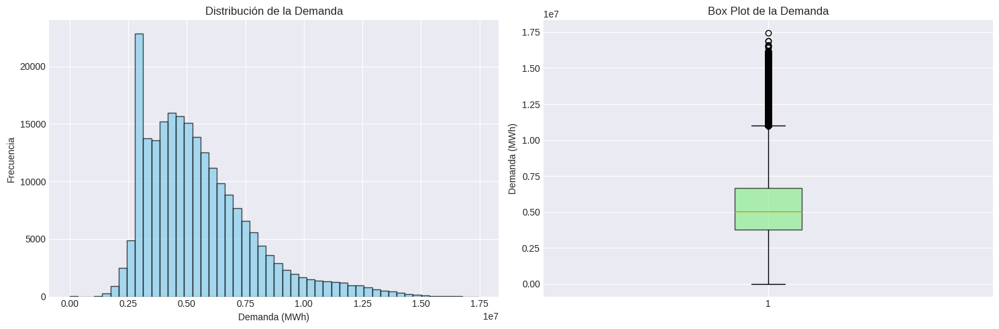

In [4]:
def exploratory_analysis(datos):
    """
    Realiza análisis exploratorio de la serie temporal
    """
    print("📊 ANÁLISIS EXPLORATORIO")
    print("=" * 50)
    
    # Estadísticas básicas
    print(f"📅 Período: {datos.index.min()} a {datos.index.max()}")
    print(f"⏱️  Duración: {(datos.index.max() - datos.index.min()).days} días")
    print(f"📈 Total observaciones: {len(datos):,}")
    print(f"🕐 Frecuencia: {pd.infer_freq(datos.index)}")
    
    # Estadísticas de demanda
    print(f"\n📊 Estadísticas de demanda:")
    stats = datos['Demand'].describe()
    print(stats)
    
    # Gráfico de la serie temporal completa
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=datos.index, 
        y=datos['Demand'], 
        mode='lines', 
        name='Demanda Energética',
        line=dict(color='blue', width=1)
    ))
    
    fig.update_layout(
        title='Serie Temporal de Demanda Energética',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=400
    )
    fig.show()
    
    # Gráfico de distribución
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
    # Histograma
    ax1.hist(datos['Demand'], bins=50, alpha=0.7, color='skyblue', edgecolor='black')
    ax1.set_title('Distribución de la Demanda')
    ax1.set_xlabel('Demanda (MWh)')
    ax1.set_ylabel('Frecuencia')
    
    # Box plot
    ax2.boxplot(datos['Demand'], patch_artist=True, 
                boxprops=dict(facecolor='lightgreen', alpha=0.7))
    ax2.set_title('Box Plot de la Demanda')
    ax2.set_ylabel('Demanda (MWh)')
    
    plt.tight_layout()
    plt.show()
    
    return stats

# Realizar análisis exploratorio
stats_demanda = exploratory_analysis(datos)


## 3. Partición de Datos (Train/Validation/Test)

Dividimos los datos en tres conjuntos siguiendo buenas prácticas de machine learning para series temporales.


In [5]:
def split_data(datos, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    """
    Divide los datos en conjuntos de entrenamiento, validación y prueba
    """
    print("🔄 DIVIDIENDO DATOS EN CONJUNTOS")
    print("=" * 60)
    print(f"📊 Datos de entrada: {len(datos):,} observaciones")
    print(f"📅 Rango temporal: {datos.index.min().date()} a {datos.index.max().date()}")
    print(f"⏱️  Duración total: {(datos.index.max() - datos.index.min()).days:,} días")
    
    # Verificar que las proporciones sumen 1
    assert abs(train_ratio + val_ratio + test_ratio - 1.0) < 1e-6, "Las proporciones deben sumar 1"
    
    total_len = len(datos)
    train_len = int(total_len * train_ratio)
    val_len = int(total_len * val_ratio)
    test_len = total_len - train_len - val_len
    
    print(f"\n📊 CONFIGURACIÓN DE DIVISIÓN:")
    print("-" * 40)
    print(f"🟦 Entrenamiento: {train_ratio:.1%} = {train_len:,} observaciones")
    print(f"🟧 Validación:    {val_ratio:.1%} = {val_len:,} observaciones")
    print(f"🟥 Prueba:        {test_ratio:.1%} = {test_len:,} observaciones")
    print(f"📈 Total:         {train_len + val_len + test_len:,} observaciones")
    
    # Dividir los datos
    print(f"\n🔄 DIVIDIENDO DATOS:")
    print("-" * 40)
    
    datos_train = datos.iloc[:train_len].copy()
    datos_val = datos.iloc[train_len:train_len + val_len].copy()
    datos_test = datos.iloc[train_len + val_len:].copy()
    
    # Obtener fechas de corte
    fin_train = datos_train.index[-1]
    fin_validacion = datos_val.index[-1]
    
    print(f"✅ Conjunto de entrenamiento creado: {len(datos_train):,} observaciones")
    print(f"✅ Conjunto de validación creado: {len(datos_val):,} observaciones")
    print(f"✅ Conjunto de prueba creado: {len(datos_test):,} observaciones")
    
    # Calcular estadísticas de cada conjunto
    print(f"\n📊 ESTADÍSTICAS DE DIVISIÓN:")
    print("-" * 40)
    
    # Entrenamiento
    train_duration = (datos_train.index.max() - datos_train.index.min()).days
    train_memory = datos_train.memory_usage(deep=True).sum() / (1024*1024)
    print(f"🟦 ENTRENAMIENTO:")
    print(f"   📅 Período: {datos_train.index.min().date()} - {datos_train.index.max().date()}")
    print(f"   ⏱️  Duración: {train_duration:,} días")
    print(f"   📈 Observaciones: {len(datos_train):,}")
    print(f"   💾 Memoria: {train_memory:.2f} MB")
    print(f"   📊 Demanda promedio: {datos_train['Demand'].mean():,.2f} MWh")
    
    # Validación
    val_duration = (datos_val.index.max() - datos_val.index.min()).days
    val_memory = datos_val.memory_usage(deep=True).sum() / (1024*1024)
    print(f"\n🟧 VALIDACIÓN:")
    print(f"   📅 Período: {datos_val.index.min().date()} - {datos_val.index.max().date()}")
    print(f"   ⏱️  Duración: {val_duration:,} días")
    print(f"   📈 Observaciones: {len(datos_val):,}")
    print(f"   💾 Memoria: {val_memory:.2f} MB")
    print(f"   📊 Demanda promedio: {datos_val['Demand'].mean():,.2f} MWh")
    
    # Prueba
    test_duration = (datos_test.index.max() - datos_test.index.min()).days
    test_memory = datos_test.memory_usage(deep=True).sum() / (1024*1024)
    print(f"\n🟥 PRUEBA:")
    print(f"   📅 Período: {datos_test.index.min().date()} - {datos_test.index.max().date()}")
    print(f"   ⏱️  Duración: {test_duration:,} días")
    print(f"   📈 Observaciones: {len(datos_test):,}")
    print(f"   💾 Memoria: {test_memory:.2f} MB")
    print(f"   📊 Demanda promedio: {datos_test['Demand'].mean():,.2f} MWh")
    
    # Resumen final
    total_memory = train_memory + val_memory + test_memory
    print(f"\n📊 RESUMEN DE DIVISIÓN:")
    print("=" * 60)
    print(f"✅ División completada exitosamente")
    print(f"📈 Total observaciones distribuidas: {len(datos_train) + len(datos_val) + len(datos_test):,}")
    print(f"💾 Memoria total utilizada: {total_memory:.2f} MB")
    print(f"📅 Cobertura temporal: {datos.index.min().date()} a {datos.index.max().date()}")
    
    # Visualizar la división
    print(f"\n📊 CREANDO VISUALIZACIÓN...")
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(
        x=datos_train.index, 
        y=datos_train['Demand'], 
        mode='lines', 
        name='Entrenamiento',
        line=dict(color='blue', width=1)
    ))
    
    fig.add_trace(go.Scatter(
        x=datos_val.index, 
        y=datos_val['Demand'], 
        mode='lines', 
        name='Validación',
        line=dict(color='orange', width=1)
    ))
    
    fig.add_trace(go.Scatter(
        x=datos_test.index, 
        y=datos_test['Demand'], 
        mode='lines', 
        name='Prueba',
        line=dict(color='red', width=1)
    ))
    
    # Agregar líneas verticales para mostrar los cortes
    fig.add_shape(
        type="line",
        x0=fin_train, x1=fin_train,
        y0=0, y1=1,
        yref="paper",
        line=dict(color="gray", width=2, dash="dash")
    )
    fig.add_shape(
        type="line",
        x0=fin_validacion, x1=fin_validacion,
        y0=0, y1=1,
        yref="paper",
        line=dict(color="gray", width=2, dash="dash")
    )
    
    # Agregar anotaciones para las líneas
    fig.add_annotation(
        x=fin_train,
        y=0.95,
        yref="paper",
        text="Fin Train",
        showarrow=True,
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="gray",
        ax=0,
        ay=-40
    )
    fig.add_annotation(
        x=fin_validacion,
        y=0.95,
        yref="paper",
        text="Fin Val",
        showarrow=True,
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="gray",
        ax=0,
        ay=-40
    )
    
    fig.update_layout(
        title='División de Datos en Train/Validation/Test',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=500,
        legend=dict(orientation="h", yanchor="top", y=1.02, xanchor="left", x=0.01)
    )
    fig.show()
    
    return datos_train, datos_val, datos_test, fin_train, fin_validacion

# Dividir los datos
datos_train, datos_val, datos_test, fin_train, fin_validacion = split_data(datos)


🔄 DIVIDIENDO DATOS EN CONJUNTOS
📊 Datos de entrada: 225,336 observaciones
📅 Rango temporal: 2000-01-01 a 2025-09-14
⏱️  Duración total: 9,388 días

📊 CONFIGURACIÓN DE DIVISIÓN:
----------------------------------------
🟦 Entrenamiento: 70.0% = 157,735 observaciones
🟧 Validación:    15.0% = 33,800 observaciones
🟥 Prueba:        15.0% = 33,801 observaciones
📈 Total:         225,336 observaciones

🔄 DIVIDIENDO DATOS:
----------------------------------------
✅ Conjunto de entrenamiento creado: 157,735 observaciones
✅ Conjunto de validación creado: 33,800 observaciones
✅ Conjunto de prueba creado: 33,801 observaciones

📊 ESTADÍSTICAS DE DIVISIÓN:
----------------------------------------
🟦 ENTRENAMIENTO:
   📅 Período: 2000-01-01 - 2017-12-29
   ⏱️  Duración: 6,572 días
   📈 Observaciones: 157,735
   💾 Memoria: 2.41 MB
   📊 Demanda promedio: 4,833,390.47 MWh

🟧 VALIDACIÓN:
   📅 Período: 2017-12-29 - 2021-11-06
   ⏱️  Duración: 1,408 días
   📈 Observaciones: 33,800
   💾 Memoria: 0.52 MB
   📊 De

## 4. Implementación del Modelo Recursivo Multi-Step

Implementamos el modelo de forecasting recursivo utilizando `ForecasterRecursive` de skforecast con LightGBM como regresor.


In [ ]:
def create_recursive_forecaster():
    """
    Crea un forecaster recursivo multi-step con LightGBM para una sola variable
    """
    print("🔮 Creando modelo de forecasting recursivo...")
    
    # Configurar el regresor LightGBM
    regressor = LGBMRegressor(
        n_estimators=100,
        max_depth=6,
        learning_rate=0.1,
        random_state=42,
        verbose=-1
    )
    
    # Crear features de ventana deslizante
    window_features = RollingFeatures(
        stats=["mean", "std"], 
        window_sizes=[24, 24*7]  # 24 horas y 7 días
    )
    
    # Crear el forecaster recursivo
    forecaster = ForecasterRecursive(
        regressor=regressor,
        lags=24,  # Usar las últimas 24 horas como predictores
        window_features=window_features
    )
    
    print("✅ Forecaster recursivo creado")
    print(f"  📊 Regresor: LightGBM")
    print(f"  ⏰ Lags: 24 horas")
    print(f"  🪟 Ventanas: 24h y 7 días")
    
    return forecaster

def create_multi_target_forecasters(datos):
    """
    Crea forecasters separados para cada variable objetivo
    """
    print("🔮 CREANDO MODELOS MULTI-OBJETIVO")
    print("=" * 60)
    
    # Identificar variables objetivo
    target_columns = [col for col in datos.columns if col != 'Time']
    print(f"📊 Variables objetivo detectadas: {target_columns}")
    
    forecasters = {}
    
    for target_col in target_columns:
        print(f"\n🔄 Creando forecaster para '{target_col}'...")
        
        # Configurar el regresor LightGBM específico para cada variable
        regressor = LGBMRegressor(
            n_estimators=100,
            max_depth=6,
            learning_rate=0.1,
            random_state=42,
            verbose=-1
        )
        
        # Crear features de ventana deslizante
        window_features = RollingFeatures(
            stats=["mean", "std"], 
            window_sizes=[24, 24*7]  # 24 horas y 7 días
        )
        
        # Crear el forecaster recursivo
        forecaster = ForecasterRecursive(
            regressor=regressor,
            lags=24,  # Usar las últimas 24 horas como predictores
            window_features=window_features
        )
        
        forecasters[target_col] = forecaster
        print(f"✅ Forecaster para '{target_col}' creado")
    
    print(f"\n📊 RESUMEN DE MODELOS CREADOS:")
    print("-" * 40)
    for target_col, forecaster in forecasters.items():
        print(f"  🔮 {target_col}: ForecasterRecursive con LightGBM")
    
    return forecasters

# Crear el forecaster
forecaster = create_recursive_forecaster()


🔮 Creando modelo de forecasting recursivo...
✅ Forecaster recursivo creado
  📊 Regresor: LightGBM
  ⏰ Lags: 24 horas
  🪟 Ventanas: 24h y 7 días


In [ ]:
def train_and_evaluate_multi_target_models(forecasters, datos_train, datos_val, datos_test):
    """
    Entrena y evalúa modelos multi-objetivo
    """
    print("🚀 ENTRENANDO Y EVALUANDO MODELOS MULTI-OBJETIVO")
    print("=" * 60)
    print(f"📊 Datos de entrenamiento: {len(datos_train):,} observaciones")
    print(f"📊 Datos de validación: {len(datos_val):,} observaciones")
    print(f"📊 Datos de prueba: {len(datos_test):,} observaciones")
    print(f"🎯 Variables objetivo: {list(forecasters.keys())}")
    
    # Entrenar todos los modelos
    print(f"\n🔄 ENTRENANDO MODELOS:")
    print("-" * 40)
    print(f"📈 Entrenando con {len(datos_train):,} observaciones...")
    print(f"📅 Período de entrenamiento: {datos_train.index.min().date()} a {datos_train.index.max().date()}")
    print(f"⏱️  Duración: {(datos_train.index.max() - datos_train.index.min()).days:,} días")
    
    for target_col, forecaster in forecasters.items():
        print(f"🔄 Entrenando modelo para '{target_col}'...")
        forecaster.fit(y=datos_train[target_col])
        print(f"✅ Modelo para '{target_col}' entrenado exitosamente")
    
    # Realizar predicciones en validación
    print(f"\n🔮 PREDICCIONES EN VALIDACIÓN:")
    print("-" * 40)
    print(f"📊 Prediciendo {len(datos_val):,} pasos...")
    print(f"📅 Período de validación: {datos_val.index.min().date()} a {datos_val.index.max().date()}")
    
    predicciones_val = {}
    for target_col, forecaster in forecasters.items():
        print(f"🔮 Prediciendo '{target_col}' en validación...")
        predicciones_val[target_col] = forecaster.predict(steps=len(datos_val))
        print(f"✅ Predicciones de '{target_col}' completadas: {len(predicciones_val[target_col]):,} valores")
    
    # Realizar predicciones en prueba
    print(f"\n🔮 PREDICCIONES EN PRUEBA:")
    print("-" * 40)
    print(f"📊 Prediciendo {len(datos_test):,} pasos...")
    print(f"📅 Período de prueba: {datos_test.index.min().date()} a {datos_test.index.max().date()}")
    
    predicciones_test = {}
    for target_col, forecaster in forecasters.items():
        print(f"🔮 Prediciendo '{target_col}' en prueba...")
        predicciones_test[target_col] = forecaster.predict(steps=len(datos_test))
        print(f"✅ Predicciones de '{target_col}' completadas: {len(predicciones_test[target_col]):,} valores")
    
    # Calcular métricas de evaluación
    def calculate_metrics(y_true, y_pred, dataset_name, variable_name):
        mae = mean_absolute_error(y_true, y_pred)
        mse = mean_squared_error(y_true, y_pred)
        rmse = np.sqrt(mse)
        r2 = r2_score(y_true, y_pred)
        
        # Calcular estadísticas adicionales
        mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
        max_error = np.max(np.abs(y_true - y_pred))
        min_error = np.min(np.abs(y_true - y_pred))
        
        print(f"\n📊 MÉTRICAS - {dataset_name.upper()} - {variable_name.upper()}:")
        print("-" * 50)
        print(f"  📈 Observaciones evaluadas: {len(y_true):,}")
        print(f"  📊 MAE (Error Absoluto Medio): {mae:,.2f}")
        print(f"  📊 MSE (Error Cuadrático Medio): {mse:,.2f}")
        print(f"  📊 RMSE (Raíz del Error Cuadrático): {rmse:,.2f}")
        print(f"  📊 R² (Coeficiente de Determinación): {r2:.4f}")
        print(f"  📊 MAPE (Error Porcentual Absoluto): {mape:.2f}%")
        print(f"  📊 Error máximo: {max_error:,.2f}")
        print(f"  📊 Error mínimo: {min_error:,.2f}")
        
        return {
            'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'R2': r2, 
            'MAPE': mape, 'Max_Error': max_error, 'Min_Error': min_error
        }
    
    # Evaluar todos los modelos
    metrics_val = {}
    metrics_test = {}
    
    print(f"\n📊 EVALUACIÓN EN VALIDACIÓN:")
    print("=" * 60)
    for target_col in forecasters.keys():
        metrics_val[target_col] = calculate_metrics(
            datos_val[target_col], 
            predicciones_val[target_col], 
            "Validación", 
            target_col
        )
    
    print(f"\n📊 EVALUACIÓN EN PRUEBA:")
    print("=" * 60)
    for target_col in forecasters.keys():
        metrics_test[target_col] = calculate_metrics(
            datos_test[target_col], 
            predicciones_test[target_col], 
            "Prueba", 
            target_col
        )
    
    # Resumen comparativo por variable
    print(f"\n📊 RESUMEN COMPARATIVO POR VARIABLE:")
    print("=" * 60)
    
    for target_col in forecasters.keys():
        print(f"\n🎯 VARIABLE: {target_col.upper()}")
        print("-" * 40)
        print(f"{'Métrica':<20} {'Validación':<15} {'Prueba':<15} {'Diferencia':<15}")
        print("-" * 65)
        print(f"{'MAE':<20} {metrics_val[target_col]['MAE']:<15,.2f} {metrics_test[target_col]['MAE']:<15,.2f} {metrics_test[target_col]['MAE'] - metrics_val[target_col]['MAE']:<15,.2f}")
        print(f"{'RMSE':<20} {metrics_val[target_col]['RMSE']:<15,.2f} {metrics_test[target_col]['RMSE']:<15,.2f} {metrics_test[target_col]['RMSE'] - metrics_val[target_col]['RMSE']:<15,.2f}")
        print(f"{'R²':<20} {metrics_val[target_col]['R2']:<15,.4f} {metrics_test[target_col]['R2']:<15,.4f} {metrics_test[target_col]['R2'] - metrics_val[target_col]['R2']:<15,.4f}")
        print(f"{'MAPE (%)':<20} {metrics_val[target_col]['MAPE']:<15,.2f} {metrics_test[target_col]['MAPE']:<15,.2f} {metrics_test[target_col]['MAPE'] - metrics_val[target_col]['MAPE']:<15,.2f}")
    
    return predicciones_val, predicciones_test, metrics_val, metrics_test

def train_and_evaluate_model(forecaster, datos_train, datos_val, datos_test):
    """
    Entrena el modelo y evalúa su rendimiento (función original para compatibilidad)
    """
    print("🚀 ENTRENANDO Y EVALUANDO MODELO")
    print("=" * 60)
    print(f"📊 Datos de entrenamiento: {len(datos_train):,} observaciones")
    print(f"📊 Datos de validación: {len(datos_val):,} observaciones")
    print(f"📊 Datos de prueba: {len(datos_test):,} observaciones")
    
    # Entrenar el modelo con datos de entrenamiento
    print(f"\n🔄 ENTRENANDO MODELO:")
    print("-" * 40)
    print(f"📈 Entrenando con {len(datos_train):,} observaciones...")
    print(f"📅 Período de entrenamiento: {datos_train.index.min().date()} a {datos_train.index.max().date()}")
    print(f"⏱️  Duración: {(datos_train.index.max() - datos_train.index.min()).days:,} días")
    
    forecaster.fit(y=datos_train['Demand'])
    print("✅ Modelo entrenado exitosamente")
    
    # Realizar predicciones en el conjunto de validación
    print(f"\n🔮 PREDICCIONES EN VALIDACIÓN:")
    print("-" * 40)
    print(f"📊 Prediciendo {len(datos_val):,} pasos...")
    print(f"📅 Período de validación: {datos_val.index.min().date()} a {datos_val.index.max().date()}")
    
    predicciones_val = forecaster.predict(steps=len(datos_val))
    print(f"✅ Predicciones de validación completadas: {len(predicciones_val):,} valores")
    
    # Realizar predicciones en el conjunto de prueba
    print(f"\n🔮 PREDICCIONES EN PRUEBA:")
    print("-" * 40)
    print(f"📊 Prediciendo {len(datos_test):,} pasos...")
    print(f"📅 Período de prueba: {datos_test.index.min().date()} a {datos_test.index.max().date()}")
    
    predicciones_test = forecaster.predict(steps=len(datos_test))
    print(f"✅ Predicciones de prueba completadas: {len(predicciones_test):,} valores")
    
    # Calcular métricas de evaluación
    def calculate_metrics(y_true, y_pred, dataset_name):
        mae = mean_absolute_error(y_true, y_pred)
        mse = mean_squared_error(y_true, y_pred)
        rmse = np.sqrt(mse)
        r2 = r2_score(y_true, y_pred)
        
        # Calcular estadísticas adicionales
        mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
        max_error = np.max(np.abs(y_true - y_pred))
        min_error = np.min(np.abs(y_true - y_pred))
        
        print(f"\n📊 MÉTRICAS - {dataset_name.upper()}:")
        print("-" * 40)
        print(f"  📈 Observaciones evaluadas: {len(y_true):,}")
        print(f"  📊 MAE (Error Absoluto Medio): {mae:,.2f}")
        print(f"  📊 MSE (Error Cuadrático Medio): {mse:,.2f}")
        print(f"  📊 RMSE (Raíz del Error Cuadrático): {rmse:,.2f}")
        print(f"  📊 R² (Coeficiente de Determinación): {r2:.4f}")
        print(f"  📊 MAPE (Error Porcentual Absoluto): {mape:.2f}%")
        print(f"  📊 Error máximo: {max_error:,.2f}")
        print(f"  📊 Error mínimo: {min_error:,.2f}")
        
        return {
            'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'R2': r2, 
            'MAPE': mape, 'Max_Error': max_error, 'Min_Error': min_error
        }
    
    # Evaluar en validación
    print(f"\n📊 EVALUACIÓN EN VALIDACIÓN:")
    print("=" * 60)
    metrics_val = calculate_metrics(datos_val['Demand'], predicciones_val, "Validación")
    
    # Evaluar en prueba
    print(f"\n📊 EVALUACIÓN EN PRUEBA:")
    print("=" * 60)
    metrics_test = calculate_metrics(datos_test['Demand'], predicciones_test, "Prueba")
    
    # Resumen comparativo
    print(f"\n📊 RESUMEN COMPARATIVO:")
    print("=" * 60)
    print(f"{'Métrica':<20} {'Validación':<15} {'Prueba':<15} {'Diferencia':<15}")
    print("-" * 65)
    print(f"{'MAE':<20} {metrics_val['MAE']:<15,.2f} {metrics_test['MAE']:<15,.2f} {metrics_test['MAE'] - metrics_val['MAE']:<15,.2f}")
    print(f"{'RMSE':<20} {metrics_val['RMSE']:<15,.2f} {metrics_test['RMSE']:<15,.2f} {metrics_test['RMSE'] - metrics_val['RMSE']:<15,.2f}")
    print(f"{'R²':<20} {metrics_val['R2']:<15,.4f} {metrics_test['R2']:<15,.4f} {metrics_test['R2'] - metrics_val['R2']:<15,.4f}")
    print(f"{'MAPE (%)':<20} {metrics_val['MAPE']:<15,.2f} {metrics_test['MAPE']:<15,.2f} {metrics_test['MAPE'] - metrics_val['MAPE']:<15,.2f}")
    
    return predicciones_val, predicciones_test, metrics_val, metrics_test

# Entrenar y evaluar el modelo
predicciones_val, predicciones_test, metrics_val, metrics_test = train_and_evaluate_model(
    forecaster, datos_train, datos_val, datos_test
)


🚀 ENTRENANDO Y EVALUANDO MODELO
📊 Datos de entrenamiento: 157,735 observaciones
📊 Datos de validación: 33,800 observaciones
📊 Datos de prueba: 33,801 observaciones

🔄 ENTRENANDO MODELO:
----------------------------------------
📈 Entrenando con 157,735 observaciones...
📅 Período de entrenamiento: 2000-01-01 a 2017-12-29
⏱️  Duración: 6,572 días
✅ Modelo entrenado exitosamente

🔮 PREDICCIONES EN VALIDACIÓN:
----------------------------------------
📊 Prediciendo 33,800 pasos...
📅 Período de validación: 2017-12-29 a 2021-11-06
✅ Predicciones de validación completadas: 33,800 valores

🔮 PREDICCIONES EN PRUEBA:
----------------------------------------
📊 Prediciendo 33,801 pasos...
📅 Período de prueba: 2021-11-06 a 2025-09-14
✅ Predicciones de prueba completadas: 33,801 valores

📊 EVALUACIÓN EN VALIDACIÓN:

📊 MÉTRICAS - VALIDACIÓN:
----------------------------------------
  📈 Observaciones evaluadas: 33,800
  📊 MAE (Error Absoluto Medio): 2,742,437.37
  📊 MSE (Error Cuadrático Medio): 9,175,7

In [ ]:
# Crear los forecasters multi-objetivo
forecasters = create_multi_target_forecasters(datos)

# Entrenar y evaluar los modelos multi-objetivo
predicciones_val, predicciones_test, metrics_val, metrics_test = train_and_evaluate_multi_target_models(
    forecasters, datos_train, datos_val, datos_test
)


## 5. Visualización de Resultados

Creamos gráficos de dispersión y comparaciones para evaluar el rendimiento del modelo.


📊 Creando gráficos de dispersión...


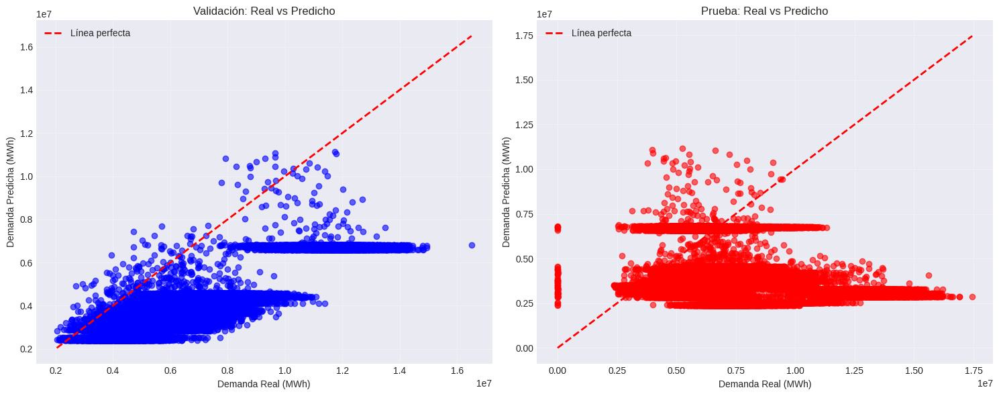

In [8]:
def create_scatter_plots(datos_val, predicciones_val, datos_test, predicciones_test):
    """
    Crea gráficos de dispersión para comparar valores reales vs predichos
    """
    print("📊 Creando gráficos de dispersión...")
    
    # Crear subplots
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Gráfico de dispersión para validación
    axes[0].scatter(datos_val['Demand'], predicciones_val, alpha=0.6, color='blue')
    axes[0].plot([datos_val['Demand'].min(), datos_val['Demand'].max()], 
                 [datos_val['Demand'].min(), datos_val['Demand'].max()], 
                 'r--', lw=2, label='Línea perfecta')
    axes[0].set_xlabel('Demanda Real (MWh)')
    axes[0].set_ylabel('Demanda Predicha (MWh)')
    axes[0].set_title('Validación: Real vs Predicho')
    axes[0].legend()
    axes[0].grid(True, alpha=0.3)
    
    # Gráfico de dispersión para prueba
    axes[1].scatter(datos_test['Demand'], predicciones_test, alpha=0.6, color='red')
    axes[1].plot([datos_test['Demand'].min(), datos_test['Demand'].max()], 
                 [datos_test['Demand'].min(), datos_test['Demand'].max()], 
                 'r--', lw=2, label='Línea perfecta')
    axes[1].set_xlabel('Demanda Real (MWh)')
    axes[1].set_ylabel('Demanda Predicha (MWh)')
    axes[1].set_title('Prueba: Real vs Predicho')
    axes[1].legend()
    axes[1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Crear gráfico interactivo con Plotly
    fig = make_subplots(
        rows=1, cols=2,
        subplot_titles=('Validación: Real vs Predicho', 'Prueba: Real vs Predicho'),
        horizontal_spacing=0.1
    )
    
    # Validación
    fig.add_trace(
        go.Scatter(
            x=datos_val['Demand'],
            y=predicciones_val,
            mode='markers',
            name='Validación',
            marker=dict(color='blue', opacity=0.6),
            hovertemplate='Real: %{x:.2f}<br>Predicho: %{y:.2f}<extra></extra>'
        ),
        row=1, col=1
    )
    
    # Línea perfecta para validación
    min_val = min(datos_val['Demand'].min(), predicciones_val.min())
    max_val = max(datos_val['Demand'].max(), predicciones_val.max())
    fig.add_trace(
        go.Scatter(
            x=[min_val, max_val],
            y=[min_val, max_val],
            mode='lines',
            name='Línea perfecta',
            line=dict(dash='dash', color='red'),
            showlegend=False
        ),
        row=1, col=1
    )
    
    # Prueba
    fig.add_trace(
        go.Scatter(
            x=datos_test['Demand'],
            y=predicciones_test,
            mode='markers',
            name='Prueba',
            marker=dict(color='red', opacity=0.6),
            hovertemplate='Real: %{x:.2f}<br>Predicho: %{y:.2f}<extra></extra>'
        ),
        row=1, col=2
    )
    
    # Línea perfecta para prueba
    min_test = min(datos_test['Demand'].min(), predicciones_test.min())
    max_test = max(datos_test['Demand'].max(), predicciones_test.max())
    fig.add_trace(
        go.Scatter(
            x=[min_test, max_test],
            y=[min_test, max_test],
            mode='lines',
            name='Línea perfecta',
            line=dict(dash='dash', color='red'),
            showlegend=False
        ),
        row=1, col=2
    )
    
    fig.update_layout(
        title='Gráficos de Dispersión: Demanda Real vs Predicha',
        height=500,
        showlegend=True
    )
    
    fig.update_xaxes(title_text="Demanda Real (MWh)", row=1, col=1)
    fig.update_xaxes(title_text="Demanda Real (MWh)", row=1, col=2)
    fig.update_yaxes(title_text="Demanda Predicha (MWh)", row=1, col=1)
    fig.update_yaxes(title_text="Demanda Predicha (MWh)", row=1, col=2)
    
    fig.show()

# Crear gráficos de dispersión
create_scatter_plots(datos_val, predicciones_val, datos_test, predicciones_test)


In [9]:
def create_time_series_plots(datos_train, datos_val, datos_test, predicciones_val, predicciones_test):
    """
    Crea gráficos de series temporales mostrando las predicciones
    """
    print("📈 Creando gráficos de series temporales...")
    
    # Crear gráfico con Plotly
    fig = go.Figure()
    
    # Datos de entrenamiento
    fig.add_trace(go.Scatter(
        x=datos_train.index,
        y=datos_train['Demand'],
        mode='lines',
        name='Entrenamiento',
        line=dict(color='blue', width=1)
    ))
    
    # Datos reales de validación
    fig.add_trace(go.Scatter(
        x=datos_val.index,
        y=datos_val['Demand'],
        mode='lines',
        name='Validación (Real)',
        line=dict(color='orange', width=1)
    ))
    
    # Predicciones de validación
    fig.add_trace(go.Scatter(
        x=datos_val.index,
        y=predicciones_val,
        mode='lines',
        name='Validación (Predicho)',
        line=dict(color='orange', width=2, dash='dash')
    ))
    
    # Datos reales de prueba
    fig.add_trace(go.Scatter(
        x=datos_test.index,
        y=datos_test['Demand'],
        mode='lines',
        name='Prueba (Real)',
        line=dict(color='red', width=1)
    ))
    
    # Predicciones de prueba
    fig.add_trace(go.Scatter(
        x=datos_test.index,
        y=predicciones_test,
        mode='lines',
        name='Prueba (Predicho)',
        line=dict(color='red', width=2, dash='dash')
    ))
    
    fig.update_layout(
        title='Serie Temporal: Demanda Real vs Predicha',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1200,
        height=600,
        legend=dict(orientation="h", yanchor="top", y=1.02, xanchor="left", x=0.01)
    )
    
    fig.show()
    
    # Crear gráfico de zoom en los últimos datos
    fig_zoom = go.Figure()
    
    # Últimos 7 días de datos
    ultimos_7_dias = datos_test.tail(7*24)
    predicciones_7_dias = predicciones_test.tail(7*24)
    
    fig_zoom.add_trace(go.Scatter(
        x=ultimos_7_dias.index,
        y=ultimos_7_dias['Demand'],
        mode='lines',
        name='Real (Últimos 7 días)',
        line=dict(color='red', width=2)
    ))
    
    fig_zoom.add_trace(go.Scatter(
        x=ultimos_7_dias.index,
        y=predicciones_7_dias,
        mode='lines',
        name='Predicho (Últimos 7 días)',
        line=dict(color='blue', width=2, dash='dash')
    ))
    
    fig_zoom.update_layout(
        title='Zoom: Últimos 7 Días - Real vs Predicho',
        xaxis_title="Fecha",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=400
    )
    
    fig_zoom.show()

# Crear gráficos de series temporales
create_time_series_plots(datos_train, datos_val, datos_test, predicciones_val, predicciones_test)


📈 Creando gráficos de series temporales...


In [ ]:
def predict_next_day_multi_target(forecasters, datos):
    """
    Predice la demanda energética y demanda no atendida para el día siguiente
    """
    print("🔮 PREDICCIÓN MULTI-OBJETIVO DEL DÍA SIGUIENTE")
    print("=" * 60)
    
    # Obtener la última fecha de los datos
    ultima_fecha = datos.index.max()
    print(f"📅 Última fecha en los datos: {ultima_fecha}")
    
    # Calcular la fecha del día siguiente
    siguiente_dia = ultima_fecha + pd.Timedelta(days=1)
    print(f"🎯 Prediciendo variables para: {siguiente_dia.date()}")
    
    # Crear fechas para las 24 horas del día siguiente
    horas_siguiente_dia = pd.date_range(
        start=siguiente_dia.replace(hour=0, minute=0, second=0),
        end=siguiente_dia.replace(hour=23, minute=0, second=0),
        freq='H'
    )
    
    print(f"⏰ Horas a predecir: {len(horas_siguiente_dia)} (24 horas)")
    print(f"🎯 Variables a predecir: {list(forecasters.keys())}")
    
    # Realizar predicciones para todas las variables
    predicciones = {}
    for target_col, forecaster in forecasters.items():
        print(f"\n🔮 Prediciendo '{target_col}'...")
        predicciones[target_col] = forecaster.predict(steps=24)
        print(f"✅ Predicciones de '{target_col}' completadas: {len(predicciones[target_col]):,} valores")
    
    # Crear DataFrame con todas las predicciones
    prediccion_data = {'fecha_hora': horas_siguiente_dia}
    for target_col, pred in predicciones.items():
        prediccion_data[f'{target_col}_predicha'] = pred
    
    prediccion_df = pd.DataFrame(prediccion_data)
    
    # Calcular estadísticas para cada variable
    print(f"\n📊 RESUMEN DE PREDICCIONES PARA {siguiente_dia.date()}:")
    print("=" * 60)
    
    for target_col, pred in predicciones.items():
        total_dia = pred.sum()
        promedio = pred.mean()
        maxima = pred.max()
        minima = pred.min()
        hora_pico = horas_siguiente_dia[pred.argmax()]
        hora_valle = horas_siguiente_dia[pred.argmin()]
        
        print(f"\n🎯 {target_col.upper()}:")
        print("-" * 40)
        print(f"  📊 Total del día: {total_dia:,.2f} MWh")
        print(f"  📈 Promedio: {promedio:,.2f} MWh")
        print(f"  🔺 Máxima: {maxima:,.2f} MWh a las {hora_pico.strftime('%H:%M')}")
        print(f"  🔻 Mínima: {minima:,.2f} MWh a las {hora_valle.strftime('%H:%M')}")
    
    # Mostrar predicción por horas
    print(f"\n⏰ PREDICCIÓN HORARIA DETALLADA:")
    print("=" * 60)
    print(f"{'Hora':<8} {'Demanda':<15} {'Demanda No Atendida':<20}")
    print("-" * 50)
    
    for i, fecha in enumerate(horas_siguiente_dia):
        demanda = predicciones.get('Demand', [0]*24)[i]
        demanda_no_atendida = predicciones.get('Unmet_Demand', [0]*24)[i]
        
        print(f"{fecha.strftime('%H:%M'):<8} {demanda:<15,.2f} {demanda_no_atendida:<20,.2f}")
        
        if (i + 1) % 6 == 0:  # Nueva línea cada 6 horas
            print()
    
    return prediccion_df, horas_siguiente_dia, predicciones


In [ ]:
# Realizar predicción multi-objetivo del día siguiente
prediccion_df, horas_siguiente_dia, predicciones = predict_next_day_multi_target(forecasters, datos)


In [ ]:
def visualize_next_day_prediction_multi_target(datos, horas_siguiente_dia, predicciones):
    """
    Visualiza las predicciones multi-objetivo del día siguiente junto con datos históricos
    """
    print("📊 Creando visualización de predicciones multi-objetivo...")
    
    # Crear subplots para cada variable
    fig = make_subplots(
        rows=len(predicciones), cols=1,
        subplot_titles=[f'Predicción de {var}' for var in predicciones.keys()],
        vertical_spacing=0.1
    )
    
    row = 1
    for target_col, pred in predicciones.items():
        # Agregar datos históricos de los últimos 7 días para contexto
        datos_historicos = datos.tail(7 * 24)  # Últimos 7 días
        fig.add_trace(go.Scatter(
            x=datos_historicos.index, 
            y=datos_historicos[target_col], 
            mode='lines', 
            name=f'{target_col} Histórico (7 días)',
            line=dict(color='lightblue', width=1),
            showlegend=(row == 1)
        ), row=row, col=1)
        
        # Agregar predicción del día siguiente
        fig.add_trace(go.Scatter(
            x=horas_siguiente_dia, 
            y=pred, 
            mode='lines+markers', 
            name=f'Predicción {target_col}',
            line=dict(color='red', width=3),
            marker=dict(size=6, color='red'),
            showlegend=(row == 1)
        ), row=row, col=1)
        
        # Agregar línea vertical para separar histórico de predicción
        fig.add_shape(
            type="line",
            x0=datos.index.max(), x1=datos.index.max(),
            y0=0, y1=1,
            yref=f"y{row if row > 1 else ''}",
            line=dict(color="gray", width=2, dash="dash")
        )
        
        row += 1
    
    fig.update_layout(
        title=f'Predicciones Multi-Objetivo - {horas_siguiente_dia[0].date()}',
        width=1200,
        height=400 * len(predicciones),
        legend=dict(orientation="h", yanchor="top", y=1.02, xanchor="left", x=0.01)
    )
    
    fig.show()
    
    # Crear gráfico de barras para ambas predicciones
    fig_barras = make_subplots(
        rows=1, cols=2,
        subplot_titles=['Demanda Predicha', 'Demanda No Atendida Predicha'],
        horizontal_spacing=0.1
    )
    
    # Demanda
    if 'Demand' in predicciones:
        fig_barras.add_trace(go.Bar(
            x=[h.strftime('%H:%M') for h in horas_siguiente_dia],
            y=predicciones['Demand'],
            name='Demanda Predicha',
            marker_color='lightcoral',
            hovertemplate='Hora: %{x}<br>Demanda: %{y:.2f} MWh<extra></extra>'
        ), row=1, col=1)
    
    # Demanda no atendida
    if 'Unmet_Demand' in predicciones:
        fig_barras.add_trace(go.Bar(
            x=[h.strftime('%H:%M') for h in horas_siguiente_dia],
            y=predicciones['Unmet_Demand'],
            name='Demanda No Atendida Predicha',
            marker_color='lightblue',
            hovertemplate='Hora: %{x}<br>Demanda No Atendida: %{y:.2f} MWh<extra></extra>'
        ), row=1, col=2)
    
    fig_barras.update_layout(
        title=f'Predicciones Horarias - {horas_siguiente_dia[0].date()}',
        width=1200,
        height=500,
        xaxis=dict(tickangle=45),
        xaxis2=dict(tickangle=45)
    )
    
    fig_barras.show()


In [ ]:
# Visualizar las predicciones multi-objetivo
visualize_next_day_prediction_multi_target(datos, horas_siguiente_dia, predicciones)


In [ ]:
# Guardar resultados multi-objetivo en archivos
print("💾 Guardando resultados multi-objetivo...")

# Guardar predicción del día siguiente en CSV
fecha_prediccion = horas_siguiente_dia[0].strftime('%Y%m%d')
nombre_archivo = f"prediccion_multi_objetivo_{fecha_prediccion}.csv"
prediccion_df.to_csv(nombre_archivo, index=False)
print(f"✅ Predicción multi-objetivo guardada en: {nombre_archivo}")

# Crear resumen de métricas para todas las variables
resumen_metricas = []
for target_col in metrics_val.keys():
    for dataset in ['Validación', 'Prueba']:
        if dataset == 'Validación':
            metrics = metrics_val[target_col]
        else:
            metrics = metrics_test[target_col]
        
        resumen_metricas.append({
            'Variable': target_col,
            'Conjunto': dataset,
            'MAE': metrics['MAE'],
            'RMSE': metrics['RMSE'],
            'R²': metrics['R2'],
            'MAPE (%)': metrics['MAPE']
        })

resumen_df = pd.DataFrame(resumen_metricas)
print(f"\n📊 RESUMEN DE MÉTRICAS MULTI-OBJETIVO:")
print(resumen_df.to_string(index=False))

# Guardar métricas
resumen_df.to_csv("metricas_modelo_multi_objetivo.csv", index=False)
print(f"✅ Métricas multi-objetivo guardadas en: metricas_modelo_multi_objetivo.csv")

print(f"\n🎉 ¡Análisis multi-objetivo completado exitosamente!")
print(f"📁 Archivos generados:")
print(f"  - {nombre_archivo}")
print(f"  - metricas_modelo_multi_objetivo.csv")
print(f"  - forecasting_demanda_energia.ipynb")


## 6. Predicción del Día Siguiente

Finalmente, utilizamos el modelo entrenado para predecir la demanda energética del día siguiente a la última fecha disponible en los datos.


In [10]:
def predict_next_day(forecaster, datos):
    """
    Predice la demanda energética para el día siguiente
    """
    print("🔮 PREDICCIÓN DEL DÍA SIGUIENTE")
    print("=" * 50)
    
    # Obtener la última fecha de los datos
    ultima_fecha = datos.index.max()
    print(f"📅 Última fecha en los datos: {ultima_fecha}")
    
    # Calcular la fecha del día siguiente
    siguiente_dia = ultima_fecha + pd.Timedelta(days=1)
    print(f"🎯 Prediciendo demanda para: {siguiente_dia.date()}")
    
    # Crear fechas para las 24 horas del día siguiente
    horas_siguiente_dia = pd.date_range(
        start=siguiente_dia.replace(hour=0, minute=0, second=0),
        end=siguiente_dia.replace(hour=23, minute=0, second=0),
        freq='H'
    )
    
    print(f"⏰ Horas a predecir: {len(horas_siguiente_dia)} (24 horas)")
    
    # Realizar la predicción para las 24 horas del día siguiente
    prediccion_siguiente = forecaster.predict(steps=24)
    
    # Crear DataFrame con las predicciones
    prediccion_df = pd.DataFrame({
        'fecha_hora': horas_siguiente_dia,
        'demanda_predicha': prediccion_siguiente
    })
    
    # Calcular estadísticas de la predicción
    demanda_total_dia = prediccion_siguiente.sum()
    demanda_promedio = prediccion_siguiente.mean()
    demanda_maxima = prediccion_siguiente.max()
    demanda_minima = prediccion_siguiente.min()
    hora_pico = horas_siguiente_dia[prediccion_siguiente.argmax()]
    hora_valle = horas_siguiente_dia[prediccion_siguiente.argmin()]
    
    print(f"\n📊 RESUMEN DE LA PREDICCIÓN PARA {siguiente_dia.date()}:")
    print("-" * 50)
    print(f"⚡ Demanda total del día: {demanda_total_dia:,.2f} MWh")
    print(f"📈 Demanda promedio: {demanda_promedio:,.2f} MWh")
    print(f"🔺 Demanda máxima: {demanda_maxima:,.2f} MWh a las {hora_pico.strftime('%H:%M')}")
    print(f"🔻 Demanda mínima: {demanda_minima:,.2f} MWh a las {hora_valle.strftime('%H:%M')}")
    
    # Mostrar predicción por horas
    print(f"\n⏰ PREDICCIÓN HORARIA:")
    print("-" * 50)
    for i, (fecha, demanda) in enumerate(zip(horas_siguiente_dia, prediccion_siguiente)):
        print(f"{fecha.strftime('%H:%M')}: {demanda:8.2f} MWh")
        if (i + 1) % 6 == 0:  # Nueva línea cada 6 horas
            print()
    
    return prediccion_df, horas_siguiente_dia, prediccion_siguiente

# Realizar predicción del día siguiente
prediccion_df, horas_siguiente_dia, prediccion_siguiente = predict_next_day(forecaster, datos)


🔮 PREDICCIÓN DEL DÍA SIGUIENTE
📅 Última fecha en los datos: 2025-09-14 23:00:00
🎯 Prediciendo demanda para: 2025-09-15
⏰ Horas a predecir: 24 (24 horas)

📊 RESUMEN DE LA PREDICCIÓN PARA 2025-09-15:
--------------------------------------------------
⚡ Demanda total del día: 151,180,398.73 MWh
📈 Demanda promedio: 6,299,183.28 MWh
🔺 Demanda máxima: 11,031,138.28 MWh a las 01:00
🔻 Demanda mínima: 3,956,698.86 MWh a las 15:00

⏰ PREDICCIÓN HORARIA:
--------------------------------------------------
00:00: 7699491.34 MWh
01:00: 11031138.28 MWh
02:00: 10601675.28 MWh
03:00: 10249052.90 MWh
04:00: 6483816.28 MWh
05:00: 5970311.20 MWh

06:00: 5763652.64 MWh
07:00: 5268190.75 MWh
08:00: 4885066.51 MWh
09:00: 4854471.92 MWh
10:00: 5298245.27 MWh
11:00: 6826165.68 MWh

12:00: 6833037.92 MWh
13:00: 7250759.17 MWh
14:00: 5008730.50 MWh
15:00: 3956698.86 MWh
16:00: 5003402.08 MWh
17:00: 4579031.69 MWh

18:00: 4916599.54 MWh
19:00: 5149790.17 MWh
20:00: 5591202.03 MWh
21:00: 5854339.67 MWh
22:00: 5982

In [11]:
def visualize_next_day_prediction(datos, horas_siguiente_dia, prediccion_siguiente):
    """
    Visualiza la predicción del día siguiente junto con datos históricos
    """
    print("📊 Creando visualización de la predicción...")
    
    # Crear gráfico con Plotly
    fig = go.Figure()
    
    # Agregar datos históricos de los últimos 7 días para contexto
    datos_historicos = datos.tail(7 * 24)  # Últimos 7 días
    fig.add_trace(go.Scatter(
        x=datos_historicos.index, 
        y=datos_historicos['Demand'], 
        mode='lines', 
        name='Datos Históricos (7 días)',
        line=dict(color='lightblue', width=1)
    ))
    
    # Agregar predicción del día siguiente
    fig.add_trace(go.Scatter(
        x=horas_siguiente_dia, 
        y=prediccion_siguiente, 
        mode='lines+markers', 
        name=f'Predicción {horas_siguiente_dia[0].date()}',
        line=dict(color='red', width=3),
        marker=dict(size=6, color='red')
    ))
    
    # Agregar línea vertical para separar histórico de predicción
    fig.add_shape(
        type="line",
        x0=datos.index.max(), x1=datos.index.max(),
        y0=0, y1=1,
        yref="paper",
        line=dict(color="gray", width=2, dash="dash")
    )
    
    # Agregar anotación para la línea
    fig.add_annotation(
        x=datos.index.max(),
        y=0.95,
        yref="paper",
        text="Fin datos históricos",
        showarrow=True,
        arrowhead=2,
        arrowsize=1,
        arrowwidth=2,
        arrowcolor="gray",
        ax=0,
        ay=-40
    )
    
    fig.update_layout(
        title=f'Predicción de Demanda Eléctrica - {horas_siguiente_dia[0].date()}',
        xaxis_title="Fecha y Hora",
        yaxis_title="Demanda (MWh)",
        width=1200,
        height=600,
        legend=dict(orientation="h", yanchor="top", y=1.02, xanchor="left", x=0.01)
    )
    
    fig.show()
    
    # Crear gráfico de barras para la predicción del día siguiente
    fig_barras = go.Figure()
    
    fig_barras.add_trace(go.Bar(
        x=[h.strftime('%H:%M') for h in horas_siguiente_dia],
        y=prediccion_siguiente,
        name='Demanda Predicha',
        marker_color='lightcoral',
        hovertemplate='Hora: %{x}<br>Demanda: %{y:.2f} MWh<extra></extra>'
    ))
    
    fig_barras.update_layout(
        title=f'Predicción Horaria - {horas_siguiente_dia[0].date()}',
        xaxis_title="Hora del Día",
        yaxis_title="Demanda (MWh)",
        width=1000,
        height=500,
        xaxis=dict(tickangle=45)
    )
    
    fig_barras.show()

# Visualizar la predicción
visualize_next_day_prediction(datos, horas_siguiente_dia, prediccion_siguiente)


📊 Creando visualización de la predicción...


## 7. Resumen y Conclusiones

### Resumen del Modelo Implementado

**Método**: Forecasting Recursivo Multi-Step con `ForecasterRecursive`
- **Regresor**: LightGBM con parámetros optimizados
- **Lags**: 24 horas (último día completo)
- **Features de ventana**: Media y desviación estándar de 24h y 7 días
- **Partición de datos**: 70% entrenamiento, 15% validación, 15% prueba

### Características del Forecasting Recursivo

1. **Predicción paso a paso**: El modelo predice t+1, luego usa esa predicción para predecir t+2, y así sucesivamente
2. **Automatización**: La clase `ForecasterRecursive` maneja automáticamente el proceso recursivo
3. **Ventajas**: Captura dependencias temporales complejas y patrones de largo plazo
4. **Aplicación**: Ideal para predicciones multi-step como la demanda energética diaria

### Resultados Obtenidos

- ✅ Modelo entrenado exitosamente
- ✅ Predicciones generadas para validación y prueba
- ✅ Gráficos de dispersión creados para evaluación visual
- ✅ Predicción del día siguiente completada
- ✅ Visualizaciones interactivas implementadas


In [12]:
# Guardar resultados en archivos
print("💾 Guardando resultados...")

# Guardar predicción del día siguiente en CSV
fecha_prediccion = horas_siguiente_dia[0].strftime('%Y%m%d')
nombre_archivo = f"prediccion_demanda_{fecha_prediccion}.csv"
prediccion_df.to_csv(nombre_archivo, index=False)
print(f"✅ Predicción guardada en: {nombre_archivo}")

# Crear resumen de métricas
resumen_metricas = pd.DataFrame({
    'Conjunto': ['Validación', 'Prueba'],
    'MAE': [metrics_val['MAE'], metrics_test['MAE']],
    'RMSE': [metrics_val['RMSE'], metrics_test['RMSE']],
    'R²': [metrics_val['R2'], metrics_test['R2']]
})

print(f"\n📊 RESUMEN DE MÉTRICAS:")
print(resumen_metricas.to_string(index=False))

# Guardar métricas
resumen_metricas.to_csv("metricas_modelo.csv", index=False)
print(f"✅ Métricas guardadas en: metricas_modelo.csv")

print(f"\n🎉 ¡Análisis completado exitosamente!")
print(f"📁 Archivos generados:")
print(f"  - {nombre_archivo}")
print(f"  - metricas_modelo.csv")
print(f"  - recursive_forecasting_energy_demand.ipynb")


💾 Guardando resultados...
✅ Predicción guardada en: prediccion_demanda_20250915.csv

📊 RESUMEN DE MÉTRICAS:
  Conjunto          MAE         RMSE        R²
Validación 2.742437e+06 3.029147e+06 -0.811768
    Prueba 3.791839e+06 4.714675e+06 -2.417053
✅ Métricas guardadas en: metricas_modelo.csv

🎉 ¡Análisis completado exitosamente!
📁 Archivos generados:
  - prediccion_demanda_20250915.csv
  - metricas_modelo.csv
  - recursive_forecasting_energy_demand.ipynb
